## Training and evaluation of different models

#### Import libraries and external functions

Only for notebooks

In [33]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [57]:
import sys
sys.path.append('/'.join(sys.path[0].split('/')[:-1]))

import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import time
import os
import healpy as hp
import random
import pickle
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm, colors


import torch
from torch import nn, optim
from torch.utils.data import Dataset, DataLoader

from modules.utils import init_device
from modules.healpix_models import UNetSphericalHealpix, UNetSphericalTempHealpix, Conv1dAuto, \
UNetSphericalHealpixResidual, _compute_laplacian_healpix, ConvBlock, ConvCheb, UNetSphericalHealpixResidual_2
from modules.test import compute_rmse_healpix
from modules.plotting import plot_rmses
from modules.full_pipeline import load_data_split, WeatherBenchDatasetXarrayHealpixTemp, \
                                  train_model_2steps, create_iterative_predictions_healpix_temp, \
                                  compute_errors, plot_climatology
from modules.plotting import plot_general_skills, plot_benchmark, plot_skillmaps, plot_benchmark_simple
from modules.data import hp_to_equiangular


import warnings
warnings.filterwarnings("ignore")

Define paths and create directories if required

In [3]:
datadir = "../data/healpix/"
input_dir = datadir + "5.625deg_nearest/"
model_save_path = datadir + "models/"
pred_save_path = datadir + t
prediction_path = '../data/healpix/predictions/'

if not os.path.isdir(model_save_path):
    os.mkdir(model_save_path)
    
if not os.path.isdir(pred_save_path):
    os.mkdir(pred_save_path)

Define constants and load data

In [4]:
chunk_size = 521

train_years = ('1990', '2012')#('1979', '2012')
val_years = ('2013', '2016')
test_years = ('2017', '2018')

nodes = 12*16*16
max_lead_time = 5*24
nb_timesteps = 2

os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="0,1"
gpu = [0,1]
num_workers = 10
pin_memory = True

nb_epochs = 20
learning_rate = 8e-3

obs = xr.open_mfdataset(pred_save_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})
rmses_weyn = xr.open_dataset(datadir + 'metrics/rmses_weyn.nc')

#### Data

Load data, define dynamic dataset and separate into train, validation and test

In [5]:
ds_train, ds_valid, ds_test = load_data_split(input_dir, train_years, val_years, test_years, chunk_size)

In [6]:
constants = xr.open_dataset(f'{input_dir}constants/constants_5.625deg_standardized.nc')

orog = constants['orog']
lsm = constants['lsm']
lats = constants['lat2d']
slt = constants['slt']

num_constants = len([orog, lats, lsm, slt])

train_mean_ = xr.open_mfdataset(f'{input_dir}mean_train_features_dynamic.nc')
train_std_ = xr.open_mfdataset(f'{input_dir}std_train_features_dynamic.nc')

Define model parameters

In [7]:
len_sqce = 2
# define time resolution
delta_t = 6

# predict 5days data
max_lead_time = 5*24
in_features = 7
out_features = 2

In [8]:
architecture_name = "spherical_unet_resnet_2"
description = "all_const_len{}_delta_{}_architecture_".format(len_sqce, delta_t) + architecture_name

model_filename = model_save_path + description + ".h5"
pred_filename = pred_save_path +  description + ".nc"
rmse_filename = datadir + 'metrics/rmse_' + description + '.nc'

Generate dataloader

In [9]:
training_ds = WeatherBenchDatasetXarrayHealpixTemp(ds=ds_train, out_features=out_features, delta_t=delta_t,
                                                   len_sqce=len_sqce, max_lead_time=max_lead_time,
                                                   years=train_years, nodes=nodes, nb_timesteps=nb_timesteps, 
                                                   mean=train_mean_, std=train_std_, load=False)

validation_ds = WeatherBenchDatasetXarrayHealpixTemp(ds=ds_valid, out_features=out_features, delta_t=delta_t,
                                                     len_sqce=len_sqce, max_lead_time=max_lead_time,
                                                     years=val_years, nodes=nodes, nb_timesteps=nb_timesteps, 
                                                     mean=train_mean_, std=train_std_, load=False)

Loading data to RAM...
Time: 30.70s
Loading data to RAM...
Time: 5.49s


#### Model

Define model, train and evaluate train and validation losses



In [10]:
spherical_unet = UNetSphericalHealpixResidual_2(N=nodes, in_channels=in_features*len_sqce, out_channels=out_features, kernel_size=3)
spherical_unet, device = init_device(spherical_unet, gpu=gpu)


In [11]:
batch_size = 100
epochs=5

In [12]:
constants_tensor = torch.tensor(xr.merge([orog, lats, lsm, slt], compat='override').to_array().values, \
                            dtype=torch.float)

# standardize 
constants_tensor = (constants_tensor - torch.mean(constants_tensor, dim=1).view(-1,1).expand(4, 3072)) / \
                    torch.std(constants_tensor, dim=1).view(-1,1).expand(4, 3072)

In [13]:
# Train model
train_loss, val_loss = train_model_2steps(spherical_unet, device, training_ds, constants_tensor.transpose(1,0), \
                                          batch_size=batch_size, epochs=epochs, \
                                           lr=learning_rate, validation_ds=validation_ds)


Batch idx: 2000; Loss: 0.097Epoch:   1/  5  - loss: 0.096  - val_loss: 0.05978  - time: 1512.667869
Batch idx: 2000; Loss: 0.046Epoch:   2/  5  - loss: 0.046  - val_loss: 0.04875  - time: 1499.791071
Batch idx: 2000; Loss: 0.041Epoch:   3/  5  - loss: 0.041  - val_loss: 0.05205  - time: 1499.649119
Batch idx: 2000; Loss: 0.037Epoch:   4/  5  - loss: 0.037  - val_loss: 0.04557  - time: 1500.136268
Batch idx: 2000; Loss: 0.035Epoch:   5/  5  - loss: 0.035  - val_loss: 0.04370  - time: 1500.666238


In [14]:
# save model
torch.save(spherical_unet.state_dict(), model_filename)

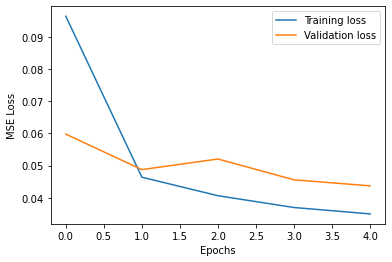

In [15]:
# Show training losses
plt.plot(train_loss, label='Training loss')
plt.plot(val_loss, label='Validation loss')
plt.xlabel('Epochs')
plt.ylabel('MSE Loss')
plt.legend()
plt.show()

del training_ds, validation_ds
torch.cuda.empty_cache()

#### Test 

Define test dataloader, generate predictions and evaluate loss

In [16]:
# Testing data
testing_ds = WeatherBenchDatasetXarrayHealpixTemp(ds=ds_test, out_features=out_features,
                                                  len_sqce=len_sqce, delta_t=delta_t, years=test_years, 
                                                  nodes=nodes, nb_timesteps=nb_timesteps, 
                                                  mean=train_mean_, std=train_std_, 
                                                  max_lead_time=max_lead_time)



Loading data to RAM...
Time: 2.52s


In [17]:
predictions, lead_times, times, nodes, out_lat, out_lon = \
create_iterative_predictions_healpix_temp(spherical_unet, device, testing_ds, constants_tensor.transpose(1,0))

Processing lead time 20 out of 20

Generate predictions ds and save it

In [18]:
das = [];
lev_idx = 0
for var in ['z', 't']:       
    das.append(xr.DataArray(
        predictions[:, :, :, lev_idx],
        dims=['lead_time', 'time', 'node'],
        coords={'lead_time': lead_times, 'time': times[:predictions.shape[1]], 'node': np.arange(nodes)},
        name=var
    ))
    lev_idx += 1

prediction_ds = xr.merge(das)
prediction_ds = prediction_ds.assign_coords({'lat': out_lat, 'lon': out_lon})

In [19]:
prediction_ds.to_netcdf(pred_filename)

Z500 - 0: 82.38847845024705
T850 - 0: 0.784116931158088


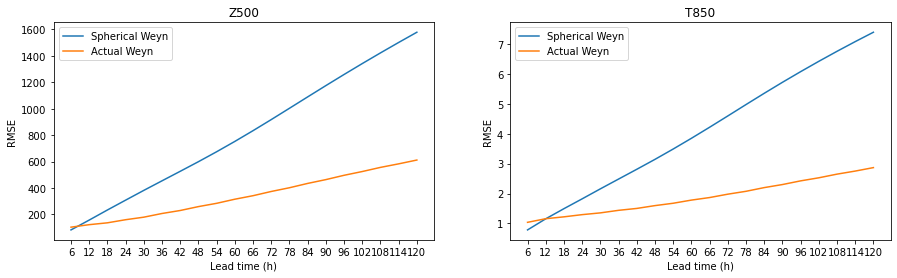

In [20]:
# Compute and save RMSE
rmse = compute_rmse_healpix(prediction_ds, obs).load()
rmse.to_netcdf(rmse_filename)

# Show RMSE
print('Z500 - 0:', rmse.z.values[0])
print('T850 - 0:', rmse.t.values[0])

plot_rmses(rmse, rmses_weyn.rename({'z500':'z', 't850':'t'}).isel(lead_time=list(range(20))), lead_time=6)

#del spherical_unet
del prediction_ds, rmse
torch.cuda.empty_cache()

#### Generate plots for evaluation

In [21]:
resolution = 5.625
lead_time = 6
start_time = len_sqce * lead_time - 6
end_time = (6-lead_time) if (6-lead_time) > 0 else None

# Data
lead_times = np.arange(lead_time, max_lead_time+lead_time, lead_time)

obs = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords')
pred = xr.open_mfdataset(prediction_path  + description + '.nc', combine='by_coords')
obs = obs.isel(time=slice(6,pred.time.shape[0]+6))

Compute errors

In [55]:
obsc = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})
predc = xr.open_mfdataset(prediction_path  + description + '.nc', combine='by_coords', chunks={'time':chunk_size})
obsc = obsc.isel(time=slice(6,pred.time.shape[0]+6))

In [56]:
t = time.time()
corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(predc, obsc)
print(time.time() - t)

time corr_map   325.8087935447693
time rbias_map  82.91916489601135
time rsd_map  120.83545923233032
time rmse map  67.60900902748108
626.6957840919495


Chunked files

In [58]:
t = time.time()
corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(predc, obsc)
print(time.time() - t)

loading data
time to load data:  0.00011467933654785156
time mean obs  30.868547201156616
time mean pred  27.939112186431885
time std obs  56.92652487754822
time std pred  56.65803050994873
time cov  59.29124712944031
time corre_map  0.0048274993896484375
time rbias map  45.9984986782074
time rsd map  0.0026242733001708984
time rmse map  44.86093831062317
363.069096326828


Not chunked files

In [48]:
t = time.time()
corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(predc, obsc)
print(time.time() - t)

loading data
time to load data:  49.794753074645996
time mean obs  24.336297273635864
time mean pred  27.681612491607666
time std obs  61.832611322402954
time std pred  73.19889307022095
time cov  60.872522592544556
time corre_map  0.0053310394287109375
time rbias map  49.044811487197876
time rsd map  0.003167867660522461
time rmse map  46.901872396469116
432.856965303421


In [22]:
corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(pred, obs)

In [23]:
metrics_path = '../data/healpix/metrics/'
figures_path = '../data/healpix/figures/' + description + '/'


In [24]:
if not os.path.isdir(figures_path):
    os.mkdir(figures_path)

In [25]:
rmse_spherical = xr.load_dataset(metrics_path + 'rmse_' + description + '.nc')
rbias_spherical = rbias_map.mean('node').compute()
rsd_spherical = rsd_map.mean('node').compute()
corr_spherical = corr_map.mean('node').compute()

In [26]:
rbias_spherical.to_netcdf(metrics_path + 'rbias_' + description + '.nc')
rsd_spherical.to_netcdf(metrics_path + 'rsd_' + description + '.nc')
corr_spherical.to_netcdf(metrics_path + 'corr_' + description + '.nc')

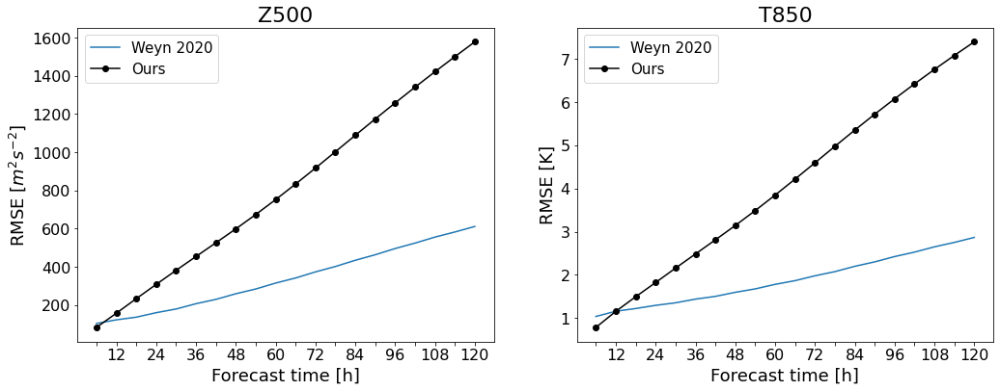

In [27]:
plot_benchmark_simple(rmse_spherical, description, lead_times, 
               input_dir=metrics_path, output_dir=figures_path, title=False)

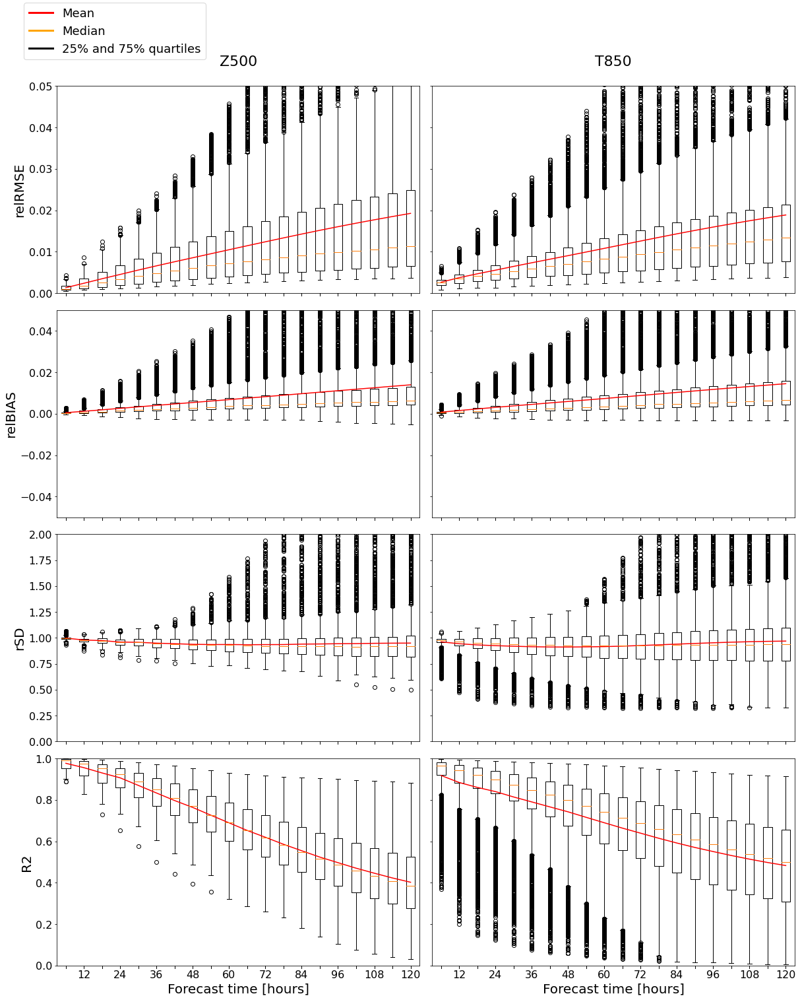

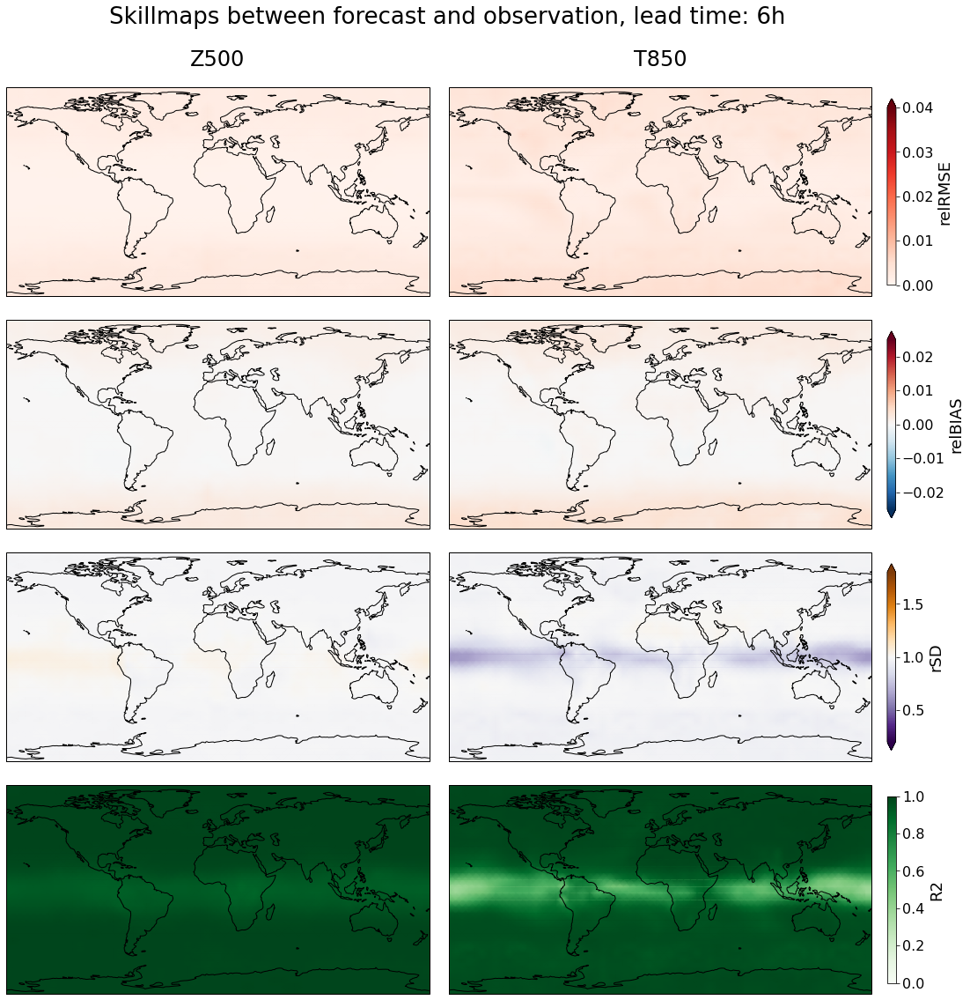

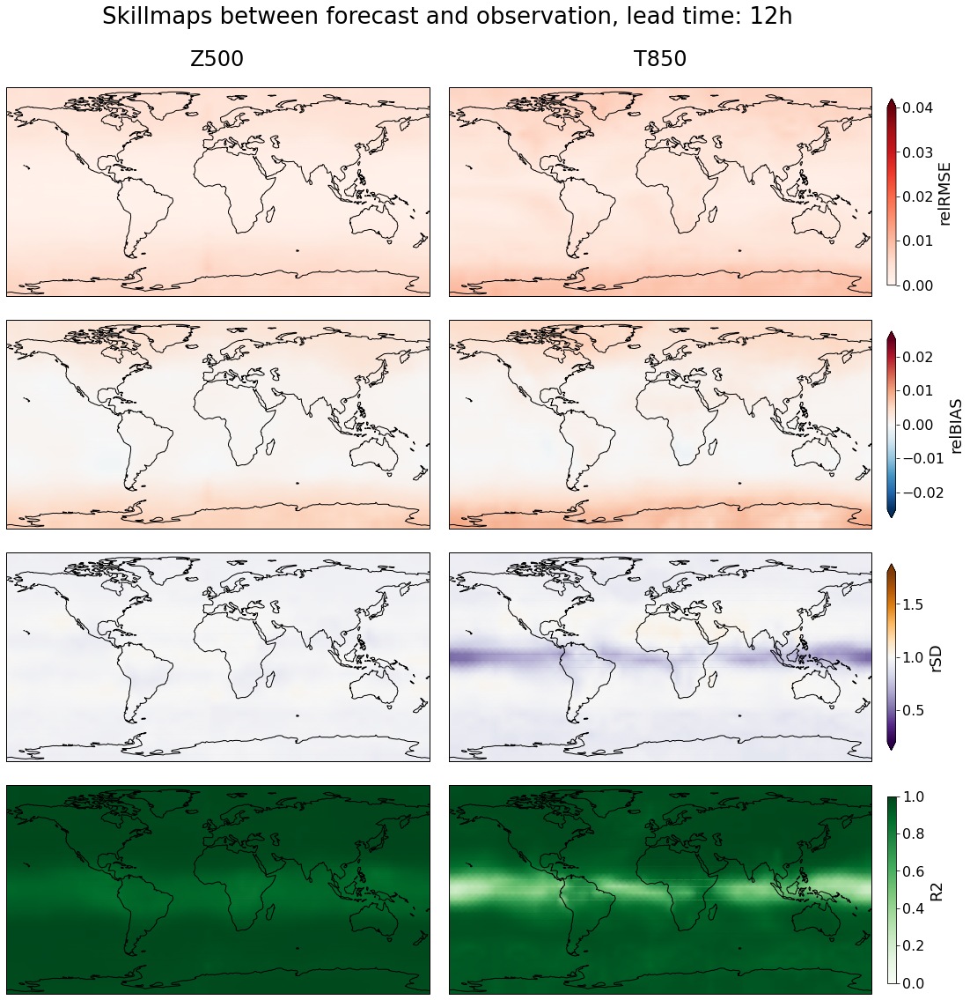

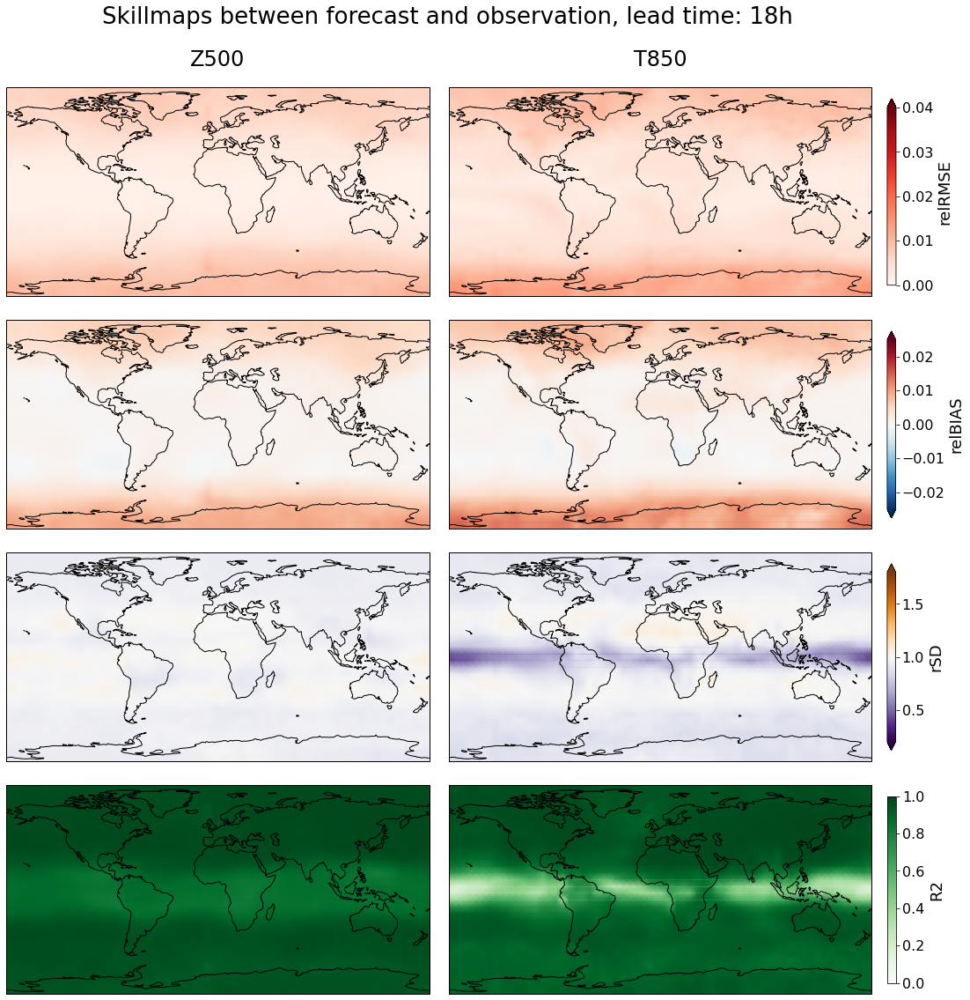

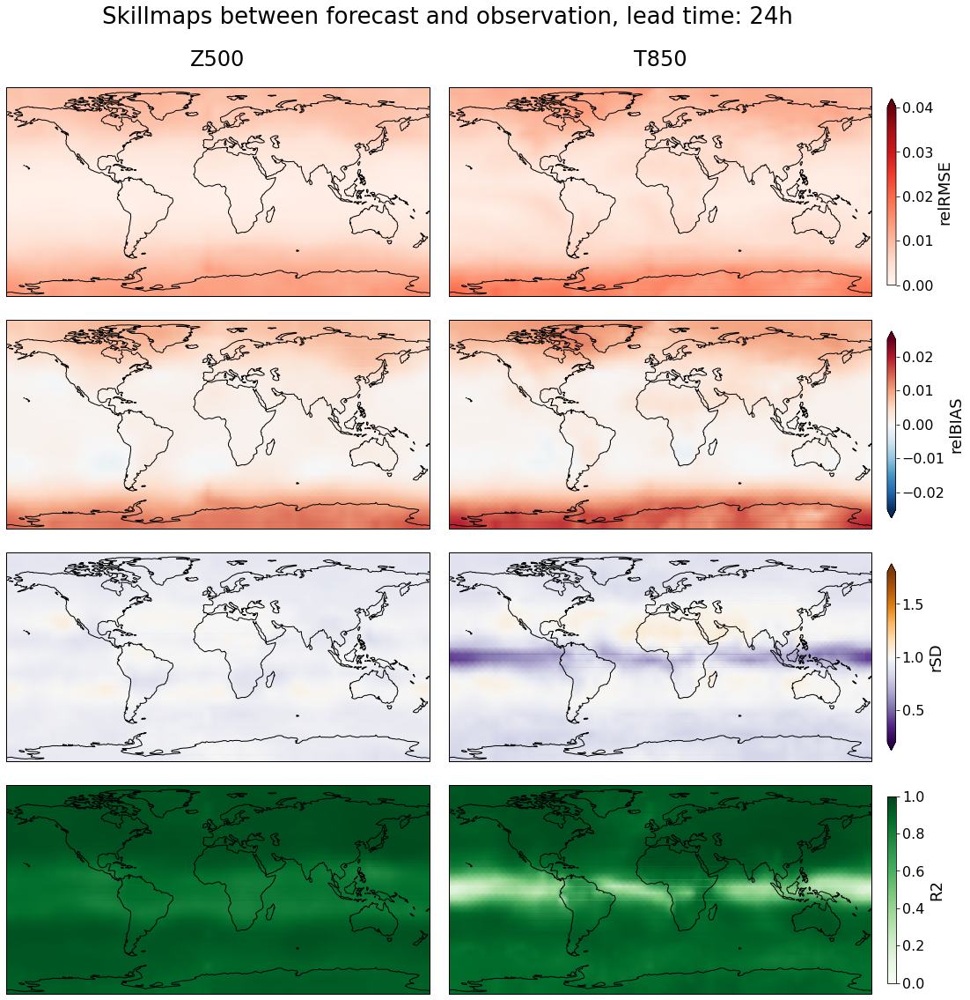

...

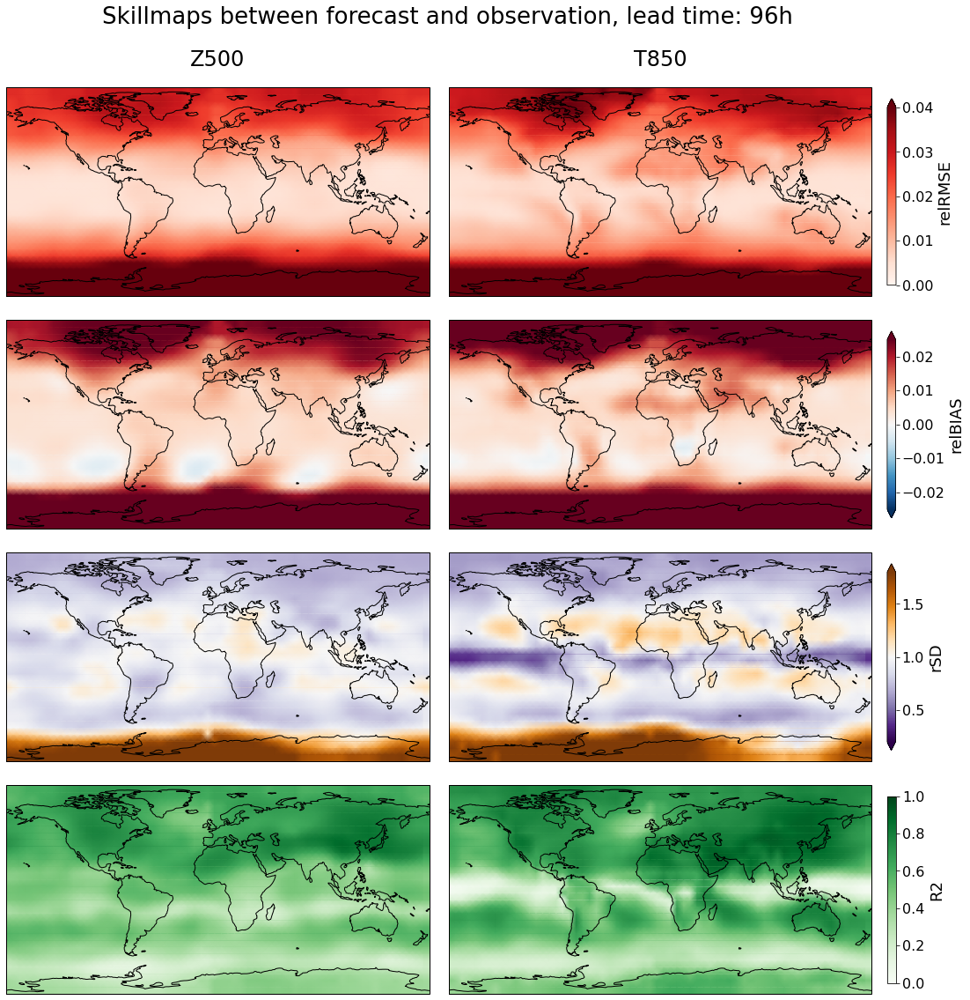

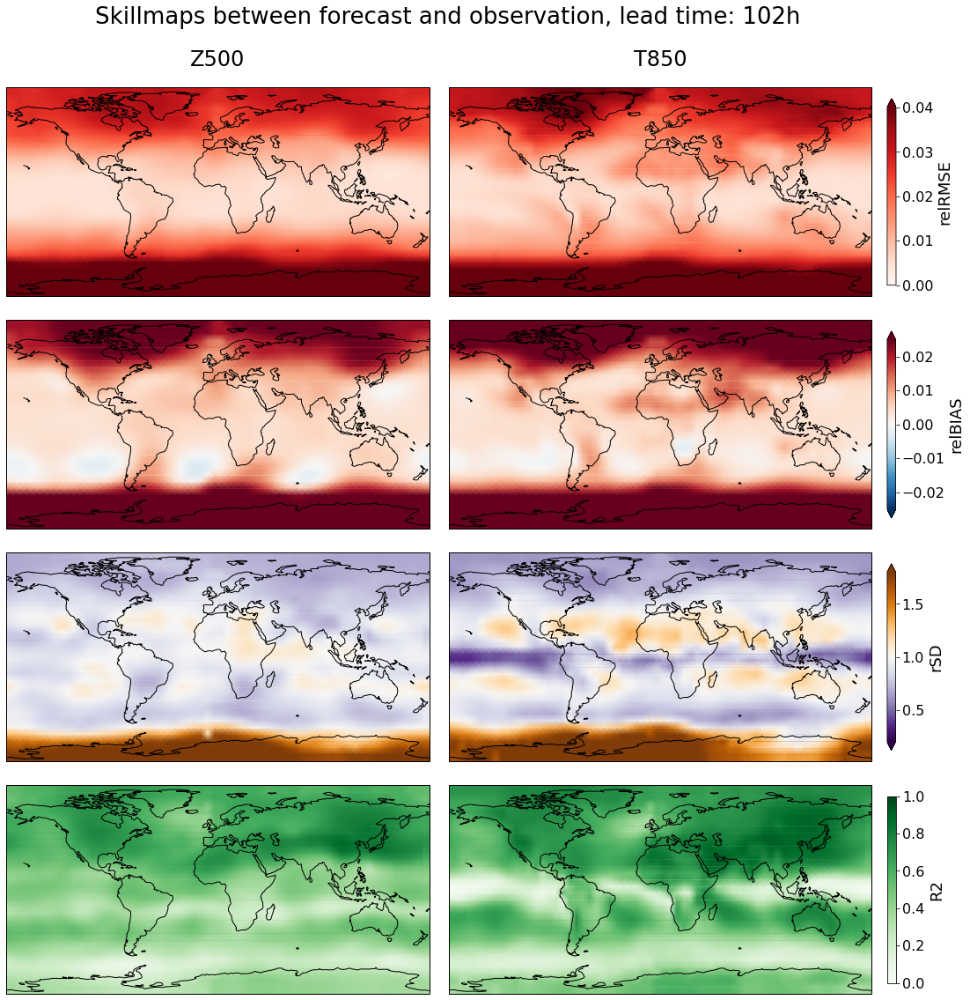

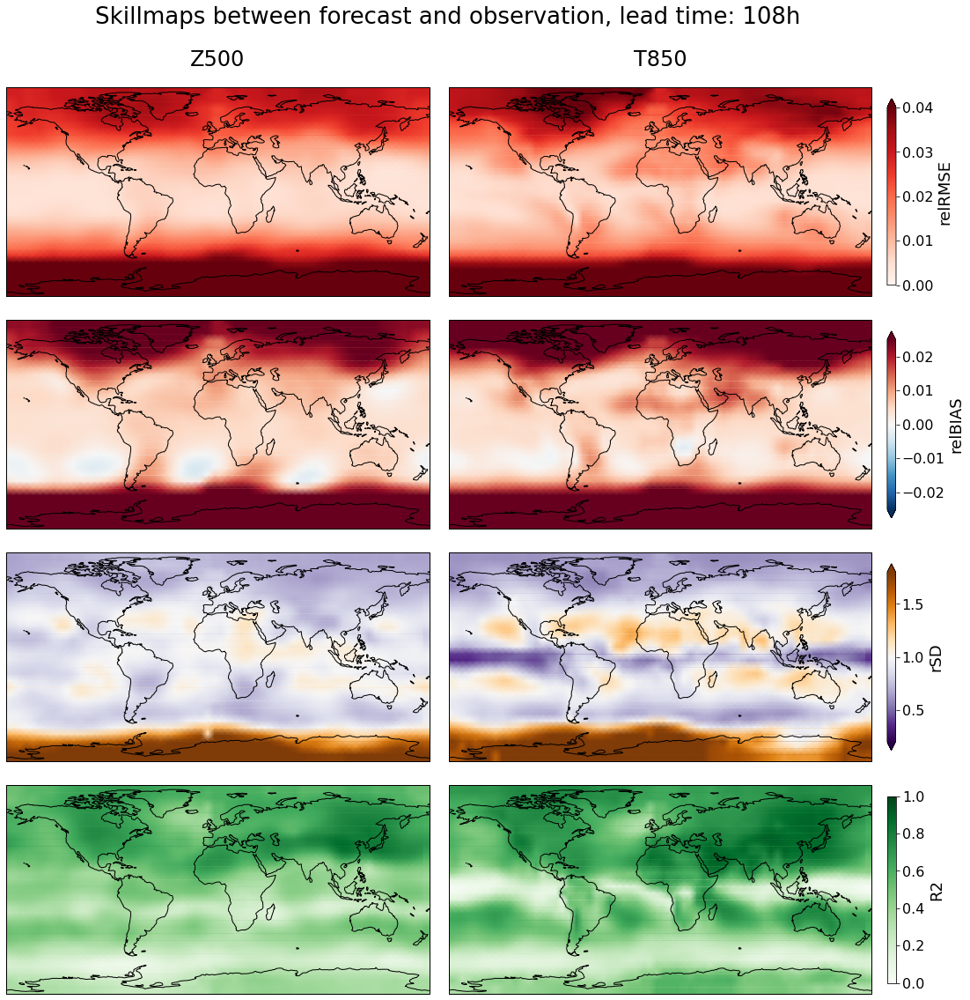

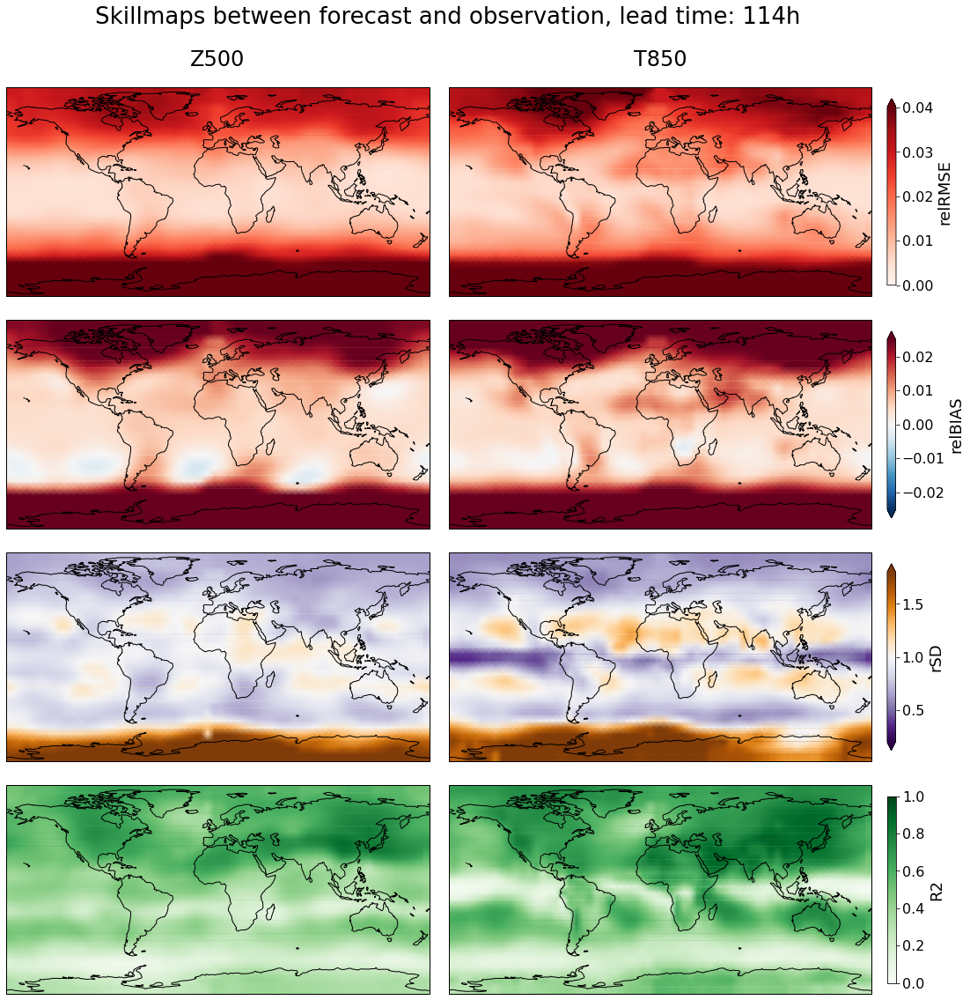

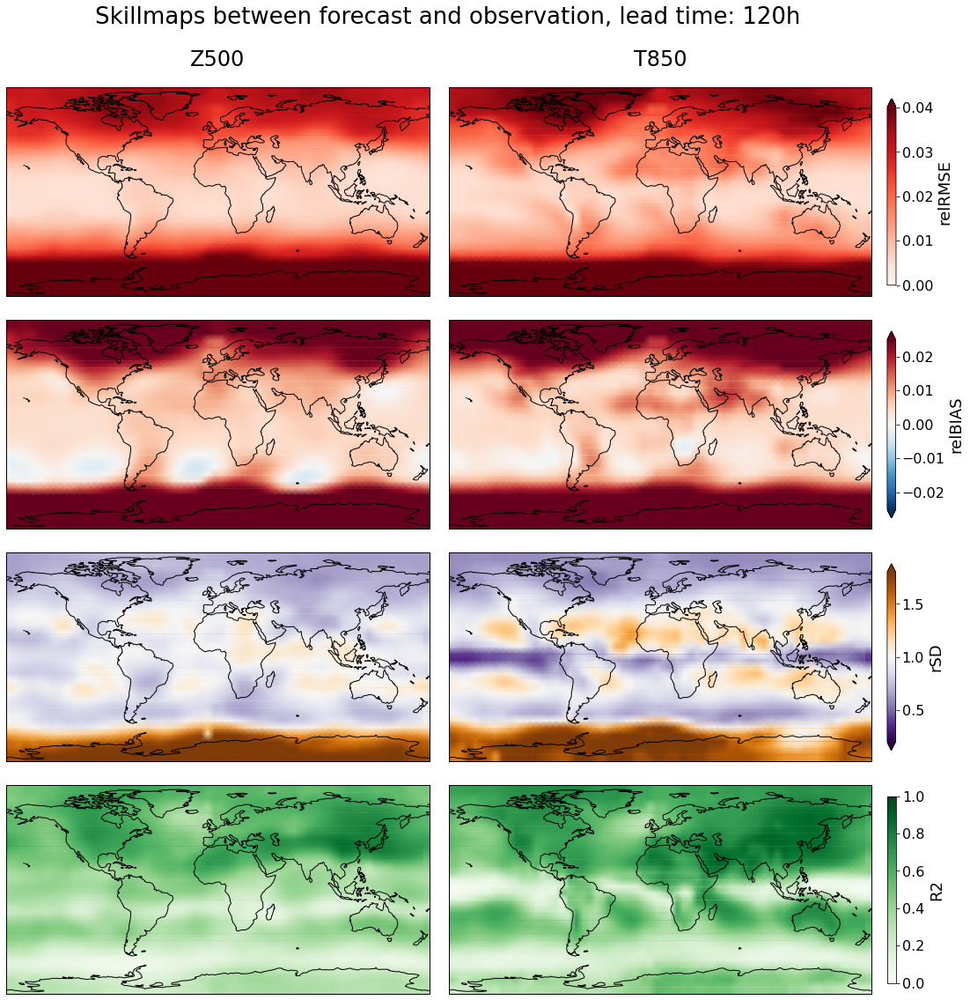

In [28]:
plot_general_skills(rmse_map_norm, corr_map, rbias_map, rsd_map, description, lead_times, 
                    output_dir=figures_path, title=False)

plot_skillmaps(rmse_map_norm, rsd_map, rbias_map, corr_map, description, lead_times, resolution, 
               output_dir=figures_path)

Climatology Hovmoller

In [29]:
monthly_mean = pred.groupby('time.month').mean().compute()
monthly_mean_obs = obs.groupby('time.month').mean().compute()

In [30]:
lead_idx = 19

# Computations
monthly_mean.isel(lead_time=lead_idx)
monthly_mean_eq = []
for month in range(12):
    monthly_mean_eq.append(hp_to_equiangular(monthly_mean.isel(lead_time=lead_idx, month=month), 
                                     resolution))
monthly_mean_eq = xr.concat(monthly_mean_eq, pd.Index(np.arange(1, 13, 1), name='month'))
monthly_lat_eq = monthly_mean_eq.mean('lon')

monthly_mean_obs.isel(lead_time=lead_idx)
monthly_mean_eq_obs = []
for month in range(12):
    monthly_mean_eq_obs.append(hp_to_equiangular(monthly_mean_obs.isel(lead_time=lead_idx, month=month), 
                                     resolution))
monthly_mean_eq_obs = xr.concat(monthly_mean_eq_obs, pd.Index(np.arange(1, 13, 1), name='month'))
monthly_lat_eq_obs = monthly_mean_eq_obs.mean('lon')

pred_z = np.rot90(monthly_lat_eq.z.values, 3)
pred_t = np.rot90(monthly_lat_eq.t.values, 3)
obs_z = np.rot90(monthly_lat_eq_obs.z.values, 3)
obs_t = np.rot90(monthly_lat_eq_obs.t.values, 3)

diff_z = pred_z / obs_z
diff_t = pred_t / obs_t

# Labels and limits
ticks = np.linspace(0, 31, 7).astype(int)
lat_labels = np.linspace(-90, 90, 7).astype(int)
month_labels = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

vmin_z = min(np.min(monthly_lat_eq.z).values.flatten()[0], np.min(monthly_lat_eq_obs.z).values.flatten()[0])
vmax_z = max(np.max(monthly_lat_eq.z).values.flatten()[0], np.max(monthly_lat_eq_obs.z).values.flatten()[0])
vmin_t = min(np.min(monthly_lat_eq.t).values.flatten()[0], np.min(monthly_lat_eq_obs.t).values.flatten()[0])
vmax_t = max(np.max(monthly_lat_eq.t).values.flatten()[0], np.max(monthly_lat_eq_obs.t).values.flatten()[0])

delta = min((np.min(diff_z)-1), (1-np.max(diff_z)), (np.min(diff_t)-1), (1-np.max(diff_t)))

vmin_sd = 1 - delta
vmax_sd = 1 + delta

In [31]:
predictions_vals = {'pred_z': pred_z, 'pred_t': pred_t,'obs_z': obs_z,'obs_t': obs_t}
val_limits = {'vmin_z':vmin_z, 'vmax_z':vmax_z, 'vmin_t':vmin_t, \
              'vmax_t':vmax_t, 'vmin_sd':vmin_sd, 'vmax_sd':vmax_sd}

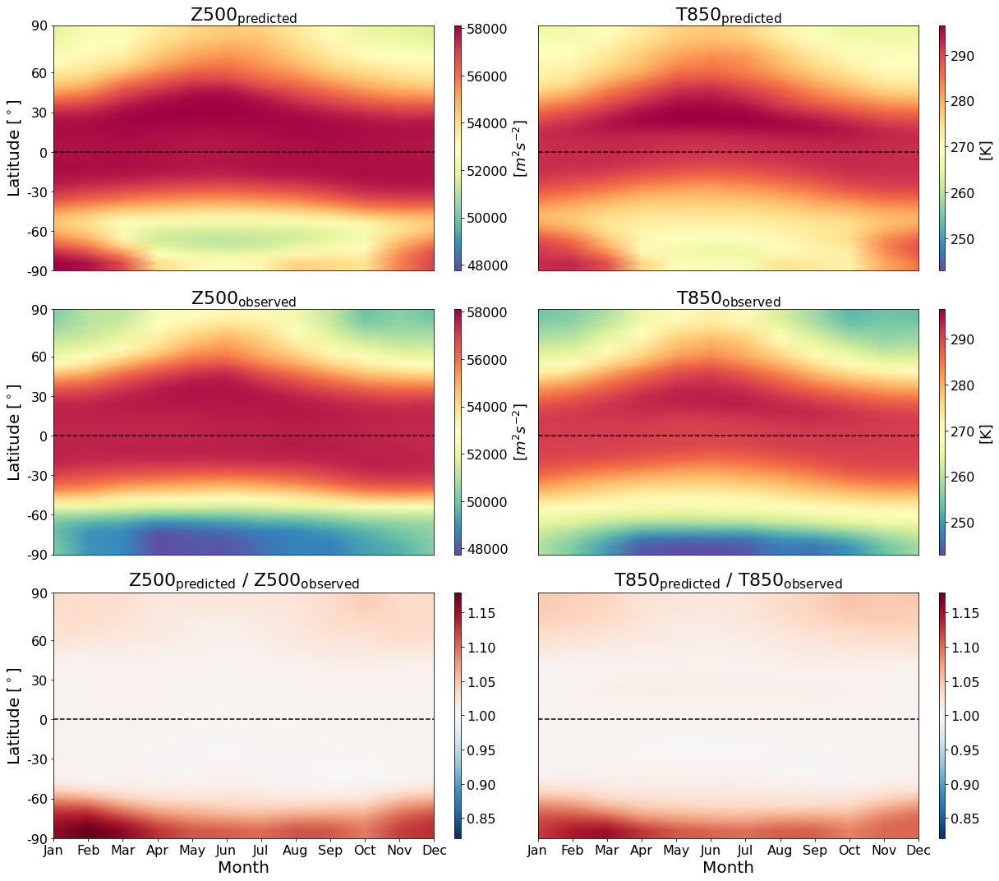

In [32]:
 
figname = figures_path + description + '_hovmoller'
plot_climatology(figname, predictions_vals, val_limits, ticks, lat_labels, month_labels)